## Data Exploration 

In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
from pathlib import Path

In [2]:
work_dir = Path.cwd()
work_dir
file_path = work_dir/'bsas_realstate_on_sale_properati_dataset_2020.csv'
work_dir

WindowsPath('c:/Users/islam/Downloads/Learn Python/TheForage/BritishAirways/buenos_aires_RealEstate')

In [3]:
real_estate_df = pd.read_csv(work_dir/'bsas_realstate_on_sale_properati_dataset_2020.csv')
real_estate_df.head() 

,start_date,end_date,created_on,lat,lon,l1,l2,l3,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,currency,title,description,property_type,operation_type
0,2019-10-17,2019-12-23,2019-10-17,-34.605880,-58.384949,Argentina,Capital Federal,San Cristobal,7.0,7.0,2.0,140.0,140.0,153000.0,USD,"***Venta semipiso centro, ideal hostel*****",DESCRIPCION DE LA PROPIEDAD: Departamento de 1...,Departamento,Venta
1,2019-10-17,2019-11-21,2019-10-17,-34.624056,-58.412110,Argentina,Capital Federal,Boedo,2.0,1.0,2.0,70.0,58.0,159000.0,USD,Espectacular PH reciclado en Boedo sin expensas.,PH reciclado en Boedo a una cuadra de la plaz...,PH,Venta
2,2019-10-17,2019-11-01,2019-10-17,-34.593569,-58.427474,Argentina,Capital Federal,Palermo,2.0,1.0,1.0,45.0,45.0,125000.0,USD,Depto.tipo casa de 2 ambientes en Venta en Pal...,"2 ambienets amplio , excelente estado , patio ...",PH,Venta
3,2019-10-17,2019-12-23,2019-10-17,-34.581294,-58.436754,Argentina,Capital Federal,Palermo,2.0,1.0,1.0,85.0,50.0,295000.0,USD,COSTA RICA 5800 / PALERMO HOLLYWOOD / VENTA PH...,HERMOSO PH EN PALERMO!!!2 AMBIENTES TOTALMENTE...,PH,Venta
4,2019-10-17,2020-03-11,2019-10-17,-34.914194,-57.938219,Argentina,Bs.As. G.B.A. Zona Sur,La Plata,2.0,1.0,1.0,50.0,35.0,40000.0,USD,58 entre 1 y 2 Venta de departamento en ph.1 ...,58 entre 1 y 2 Venta de departamento en PH. P...,PH,Venta


In [4]:
# Let's see the summary stats of numerical cols of the df
real_estate_df.describe()

,lat,lon,rooms,bedrooms,bathrooms,surface_total,surface_covered,price
count,136735.000000,136701.000000,146660.000000,146660.000000,140703.000000,126133.000000,125046.000000,1.466600e+05
mean,-34.604896,-58.465304,3.079817,1.983240,1.599994,216.872888,112.818011,2.412211e+05
std,0.468428,0.486190,1.416352,1.151304,0.889324,2037.606649,916.857584,3.185195e+05
min,-35.318457,-180.000000,1.000000,0.000000,1.000000,10.000000,1.000000,5.500000e+03
25%,-34.627667,-58.504012,2.000000,1.000000,1.000000,52.000000,47.000000,1.110000e+05
50%,-34.600943,-58.443262,3.000000,2.000000,1.000000,78.000000,68.000000,1.660000e+05
75%,-34.574600,-58.407586,4.000000,3.000000,2.000000,140.000000,108.000000,2.650000e+05
max,85.051129,-57.805832,35.000000,15.000000,14.000000,193549.000000,126062.000000,3.243423e+07


We can see that there are some oddities in the summary stats. 

<li>There are properties with 0 bedrooms.</li>
<li>The min values of surface_total and surface_covered are suspiscous</li>



In [5]:
real_estate_df.describe(include='object')

,start_date,end_date,created_on,l1,l2,l3,currency,title,description,property_type,operation_type
count,146660,146660,146660,146660,146660,146660,146660,146660,146660,146660,146660
unique,366,412,366,1,4,89,1,77733,106668,10,1
top,2019-07-31,9999-12-31,2019-07-31,Argentina,Capital Federal,Palermo,USD,DEPARTAMENTO EN VENTA,EDIFICIO DE CATEGORIA CON MATERIALES Y ACCESOR...,Departamento,Venta
freq,11022,25101,11022,146660,92539,13073,146660,5064,235,107326,146660


The L1 contains the country since there is only one country Argentina, we can discard this col.

The same can be said for the currency and thr operation type cols.

The title and description cols have high cardinality (a lot of unqiue values) so let's discard those as well.

In [6]:
def wrangle(file_path):

    # read the csv file 
    df = pd.read_csv(file_path)

    # Remove the cols that don't provide any useful info and also the high cardinality cols
    cols_to_remove = [
        'start_date','end_date','created_on','l1','currency','operation_type',
        'description','title'
                      ]
    


    df = df.drop(cols_to_remove,axis=1)

    return df

In [7]:
# Remove the date cols as they seem redundant for analysis
cols_to_remove = [
        'start_date','end_date','created_on','l1','currency','operation_type',
        'description','title'
                      ]
    
real_estate_df = real_estate_df.drop(cols_to_remove,axis=1)

In [8]:
real_estate_df.head()

,lat,lon,l2,l3,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,property_type
0,-34.605880,-58.384949,Capital Federal,San Cristobal,7.0,7.0,2.0,140.0,140.0,153000.0,Departamento
1,-34.624056,-58.412110,Capital Federal,Boedo,2.0,1.0,2.0,70.0,58.0,159000.0,PH
2,-34.593569,-58.427474,Capital Federal,Palermo,2.0,1.0,1.0,45.0,45.0,125000.0,PH
3,-34.581294,-58.436754,Capital Federal,Palermo,2.0,1.0,1.0,85.0,50.0,295000.0,PH
4,-34.914194,-57.938219,Bs.As. G.B.A. Zona Sur,La Plata,2.0,1.0,1.0,50.0,35.0,40000.0,PH


Now that the df is looking a bit cleaner let's start investigating the data itself.

In [9]:
def plot_df(df):
    
    # Select numeric columns
    numeric_columns = df.select_dtypes(include='number').columns
    categorical_columns = df.select_dtypes(include='object').columns

    # Filter out cols with high unqiue values during initial visualization
    categorical_columns = categorical_columns.drop([col for col in categorical_columns if len(real_estate_df[col].unique())>15])

    # Define the number of rows and columns for the grid
    ncols = 3  # Number of columns in the grid
    nrows = (len(numeric_columns) + len(categorical_columns) + ncols - 1) // ncols  # Calculate rows needed

    # Create subplots
    fig, axes = plt.subplots(nrows, ncols, figsize=(15, 5 * nrows))
    axes = axes.flatten()  # Flatten to make indexing easier

    # Set the seaborn style and color palette
    sns.set(style="whitegrid")  # Set style for clean background
    palette = sns.color_palette("muted")  # A soft yet vibrant color palette

    # Loop through each numeric column and plot on a subplot
    for i, column in enumerate(numeric_columns):
        sns.histplot(df[column], kde=True, ax=axes[i], color=palette[i % len(palette)])  # Use a color from the palette
        axes[i].set_title(f'Distribution of {column}', fontsize=14, fontweight='bold')
        axes[i].set_xlabel(column, fontsize=12)
        axes[i].set_ylabel('Frequency', fontsize=12)

    # Plot categorical columns as count plots
    for i, column in enumerate(categorical_columns, start=len(numeric_columns)):
        sns.countplot(data=df, x=column, ax=axes[i], hue=column)  # Use a color from the palette
        axes[i].set_title(f'Category Distribution of {column}', fontsize=14, fontweight='bold')
        axes[i].set_xlabel(column, fontsize=12)
        axes[i].set_ylabel('Count', fontsize=12)
        axes[i].tick_params(axis='x', rotation=45)  # Rotate x-axis labels for better readability

    # Hide any empty subplots
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')

    # Adjust layout
    plt.tight_layout()
    plt.show()
    

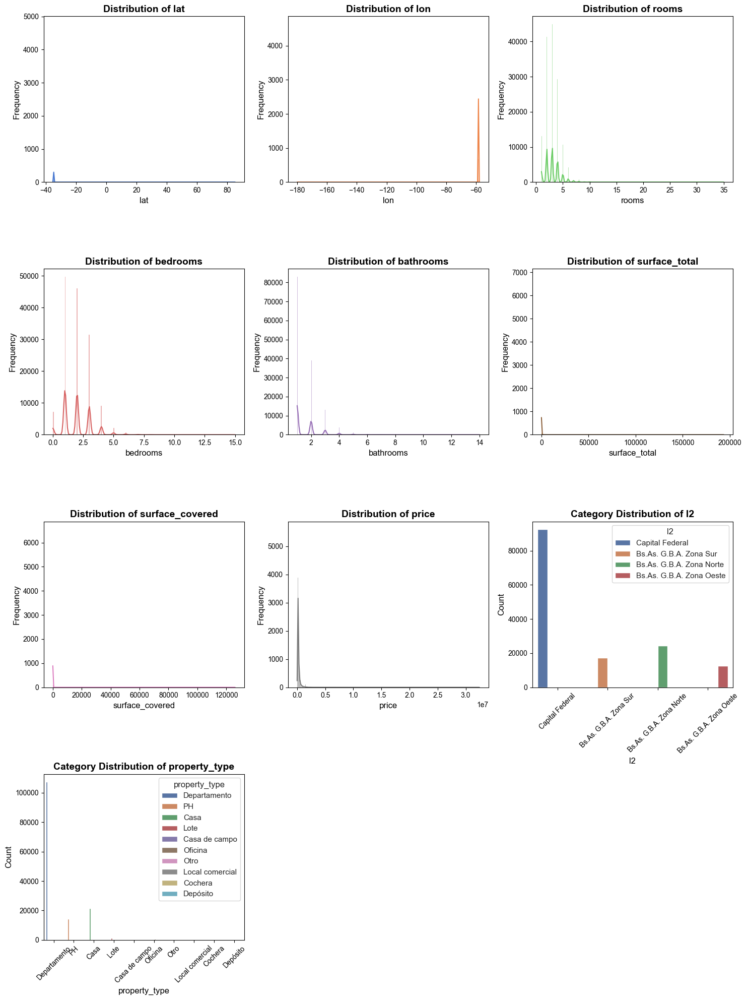

In [13]:
plot_df(real_estate_df)

From the graphs above we can see that a few outliers in our dataset skew the visualizations by a lot. Most of our houses are of type apartments 'Departamento'. Additionally, the capital city has the higest number of property listings. Since, we are cosidering residential homes only lets filter out other property types. We also don't care about the outliers in our data so let's get rid of the expensive properties priced at values greater than <code>1e6</code> and let's also remove the data from other cities as we don't have as many records and are not really intersested in them.


In [10]:
def wrangle(file_path):

    # read the csv file 
    df = pd.read_csv(file_path)

    # Remove the cols that don't provide any useful info and also the high cardinality cols
    cols_to_remove = [
        'start_date','end_date','created_on','l1','currency','operation_type',
        'description','title'
                      ]
    
    # Filter the df to exclude properties > 5e5 / 500_000 and less than 1e4/ 10_000
    mask_price = [df.prices<=5e5 & df.prices>1e4] 
    # Filter properties to contain only apartments, condos and, houses/homes
    mask_property_type = df.property_type.isin(['PH', 'Departamento','Casa']) 

    df  = df.loc[mask_price & mask_property_type]

    # Filter properties to include only the captial 

    # Change the property_type col values to ENG
    df['property_type'] = df.property_type.map(
    {
        'Departamento':'Apartment',
        'Casa':'House',
        'PH':'Condo'
     } 
    )

    # Remove 

    df = df.drop(cols_to_remove,axis=1)

    return df

In [11]:
real_estate_df_filtered  = real_estate_df.loc[real_estate_df.price<=5e5]

Text(0.5, 1.0, 'Distribution of price of the properties')

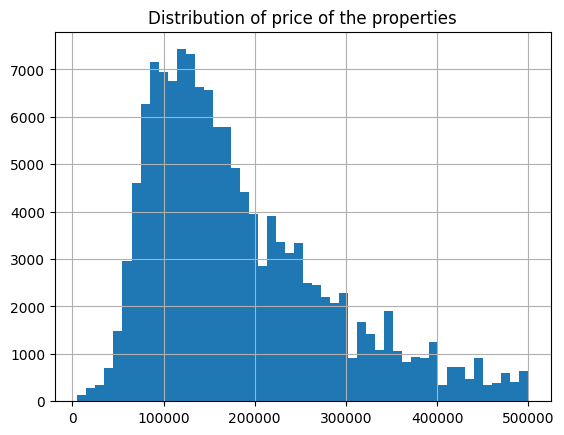

In [12]:
(real_estate_df_filtered.price).hist(bins=50)
plt.title('Distribution of price of the properties')

In [13]:
# We want to only see the price of apartments, condos and homes all other property types are not of concern
# In our case it means we are interested in 'PH', 'Departamento', and, 'Casa'

real_estate_df_filtered = real_estate_df_filtered.loc[real_estate_df_filtered.property_type.isin(['PH', 'Departamento','Casa'])]


In [14]:
real_estate_df_filtered.property_type.value_counts()

Departamento    99680
Casa            19388
PH              14036
Name: property_type, dtype: int64

In [15]:
real_estate_df_filtered['property_type'] =real_estate_df_filtered.property_type.map(
    {
        'Departamento':'Apartment',
        'Casa':'House',
        'PH':'Condo'
     }
)

In [17]:
fig = px.scatter_mapbox(
    real_estate_df_filtered,
    lat=real_estate_df_filtered.lat,
    lon=real_estate_df_filtered.lon,
    center={'lat':-34.60,'lon':-58.46},
    color=real_estate_df_filtered.price,
    width=600,
    height=600,
    hover_data=['price']

)

fig.update_layout(mapbox_style='open-street-map')

fig.show()

From the image above we can see that the vast majority of the properties fall within 10K-200K range. 
From the map it is somewhat apparent that certain areas are dominated by higher priced properties. 
This indicates that in certain areas the avg. price of properties may be higher and that lat, lon may be useful features to predict the price.

In [16]:
def wrangle(file_path):

    # read the csv file 
    df = pd.read_csv(file_path)

    # Remove the cols that don't provide any useful info and also the high cardinality cols
    cols_to_remove = [
        'start_date','end_date','created_on','l1','currency','operation_type',
        'description','title'
                      ]
    
    # Filter the df to exclude properties > 5e5 / 500_000 and less than 1e4/ 10_000
    mask_price = (df.price<=5e5) & (df.price>1e4)
    # Filter properties to contain only apartments, condos and, houses/homes
    mask_property_type = df.property_type.isin(['PH', 'Departamento','Casa']) 

    # Filter df to only  include properties in the captial fedeeral district
    mask_city = df['l2']=='Capital Federal'
    cols_to_remove.append('l2')
    
    
    df  = df.loc[mask_price & mask_property_type & mask_city ]

     

    # Change the property_type col values to ENG
    df['property_type'] = df.property_type.map(
    {
        'Departamento':'Apartment',
        'Casa':'House',
        'PH':'Condo'
     } 
    )

    # Remove 

    df = df.drop(cols_to_remove,axis=1)

    return df

In [17]:
df  = wrangle(file_path)
df.head()

,lat,lon,l3,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,property_type
0,-34.605880,-58.384949,San Cristobal,7.0,7.0,2.0,140.0,140.0,153000.0,Apartment
1,-34.624056,-58.412110,Boedo,2.0,1.0,2.0,70.0,58.0,159000.0,Condo
2,-34.593569,-58.427474,Palermo,2.0,1.0,1.0,45.0,45.0,125000.0,Condo
3,-34.581294,-58.436754,Palermo,2.0,1.0,1.0,85.0,50.0,295000.0,Condo
5,-34.593779,-58.441239,Villa Crespo,2.0,1.0,1.0,56.0,56.0,150000.0,Condo


In [18]:
df.isna().sum()

lat                3661
lon                3675
l3                    0
rooms                 0
bedrooms              0
bathrooms          2082
surface_total      8472
surface_covered    8768
price                 0
property_type         0
dtype: int64

Let's investigate the null values. 

For lat, lon let's drop the null values as there is a low chance that any form of imputation will impute the values accurately.

Since there is bound to be data leakage from the bed, bath, room cols lets just use the rooms which is bed + bathrooms and discard the bathrooms col.

Let's investigate which col among the surface_total and surface_covered might prove to be more useful and then discard the one which is not seleted as a feature.

In [19]:
df.surface_covered.sort_values(ascending=False).head()

90235     126062.0
13243     126062.0
102042    104890.0
42655      47360.0
118389     21920.0
Name: surface_covered, dtype: float64

In [20]:
df.surface_total.sort_values(ascending=False).head()

90235     126062.0
35231     126062.0
13243     126062.0
36331     108960.0
102042    104890.0
Name: surface_total, dtype: float64

In [21]:
df.loc[35231]

lat               -34.606165
lon               -58.455126
l3                 Caballito
rooms                    5.0
bedrooms                 4.0
bathrooms                3.0
surface_total       126062.0
surface_covered        126.0
price               240000.0
property_type          Condo
Name: 35231, dtype: object

<AxesSubplot: >

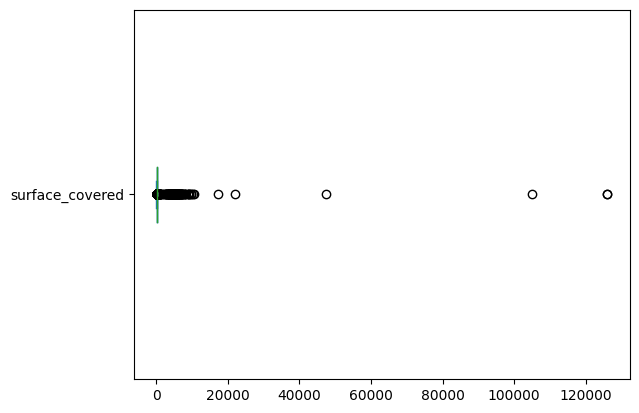

In [22]:
df['surface_covered'].plot(kind='box',vert=False)

The surface_covered columns is full of outliers, let's try and reduce/remove these outliers 
so, that the model will generalize well.

<AxesSubplot: >

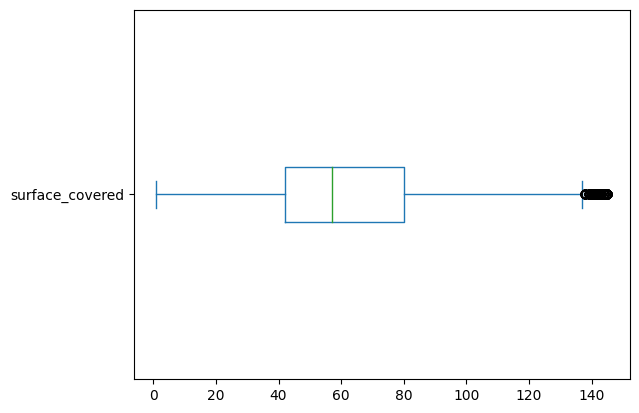

In [27]:
Q1_surface_c = df['surface_covered'].quantile(0.25)
Q3_surface_c = df['surface_covered'].quantile(0.75)
IQR_surface_c = Q3_surface_c - Q1_surface_c

surface_mask_c = df.loc[(df['surface_covered'] >= Q1_surface_c - 1.5 * IQR_surface_c) & (df['surface_covered'] <= Q3_surface_c + 1.5 * IQR_surface_c)]
surface_mask_c['surface_covered'].plot(kind='box',vert=False)

Now we can see that the outliers have been more or less removed from the dataset.

<AxesSubplot: >

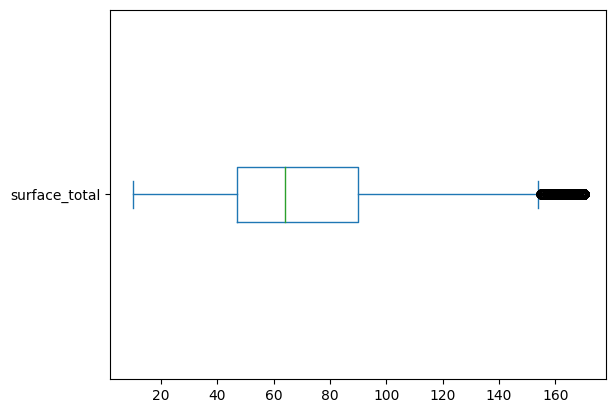

In [28]:
Q1_surface_t = df['surface_total'].quantile(0.25)
Q3_surface_t = df['surface_total'].quantile(0.75)
IQR_surface_t = Q3_surface_t - Q1_surface_t

surface_mask_t = df.loc[(df['surface_total'] >= Q1_surface_t - 1.5 * IQR_surface_t) & (df['surface_total'] <= Q3_surface_t + 1.5 * IQR_surface_t)]
surface_mask_t['surface_total'].plot(kind='box',vert=False)

<AxesSubplot: >

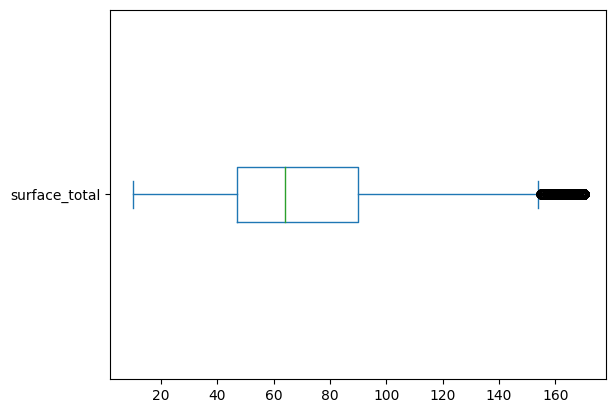

In [31]:
df.loc[df['surface_total'].between(Q1_surface_t - 1.5 * IQR_surface_t, Q3_surface_t + 1.5 * IQR_surface_t)].surface_total.plot(kind='box',vert=False)

<AxesSubplot: ylabel='Frequency'>

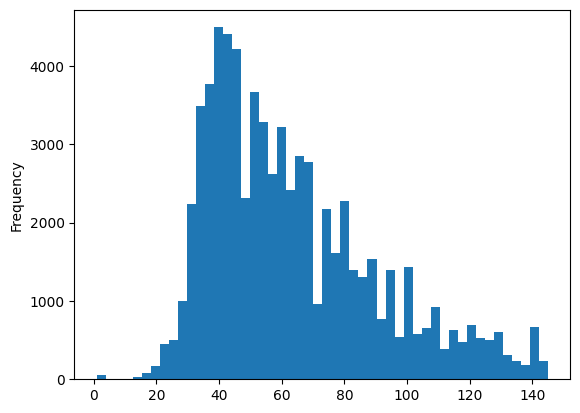

In [29]:
surface_mask_c['surface_covered'].plot(kind='hist',bins=50)

In [32]:
def wrangle(file_path):

    # read the csv file 
    df = pd.read_csv(file_path)

    # Remove the cols that don't provide any useful info and also the high cardinality cols
    cols_to_remove = [
        'start_date','end_date','created_on','l1','currency','operation_type',
        'description','title'
                      ]
    
    # Filter the df to exclude properties > 5e5 / 500_000 and less than 1e4/ 10_000
    mask_price = (df.price<=5e5) & (df.price>1e4)
    # Filter properties to contain only apartments, condos and, houses/homes
    mask_property_type = df.property_type.isin(['PH', 'Departamento','Casa']) 

    # Filter df to only  include properties in the captial fedeeral district
    mask_city = df['l2']=='Capital Federal'
    cols_to_remove.append('l2')
    
    # Filter the surface_covered and surface_total cols to remove the outliers.
    Q1_surface_c = df['surface_covered'].quantile(0.25)
    Q3_surface_c = df['surface_covered'].quantile(0.75)
    IQR_surface_c = Q3_surface_c - Q1_surface_c

    Q1_surface_t = df['surface_total'].quantile(0.25)
    Q3_surface_t = df['surface_total'].quantile(0.75)
    IQR_surface_t = Q3_surface_t - Q1_surface_t

    mask_surface_c = df['surface_covered'].between(Q1_surface_c - 1.5 * IQR_surface_c, Q3_surface_c + 1.5 * IQR_surface_c)
    mask_surface_t = df['surface_total'].between(Q1_surface_t - 1.5 * IQR_surface_t, Q3_surface_t + 1.5 * IQR_surface_t)

    # Drop NaN entries in the lat and lon columns
    df = df.dropna(subset=['lat','lon'])
    
    df  = df.loc[mask_price & mask_property_type & mask_city & mask_surface_c & mask_surface_t]
  

    # Change the property_type col values to ENG
    df['property_type'] = df.property_type.map(
    {
        'Departamento':'Apartment',
        'Casa':'House',
        'PH':'Condo'
     } 
    )

    # Remove cols

    df = df.drop(cols_to_remove,axis=1)

    return df

In [33]:
df = wrangle(file_path)
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 69774 entries, 0 to 146557
Data columns (total 10 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   lat              69774 non-null  float64
 1   lon              69774 non-null  float64
 2   l3               69774 non-null  object 
 3   rooms            69774 non-null  float64
 4   bedrooms         69774 non-null  float64
 5   bathrooms        69024 non-null  float64
 6   surface_total    69774 non-null  float64
 7   surface_covered  69774 non-null  float64
 8   price            69774 non-null  float64
 9   property_type    69774 non-null  object 
dtypes: float64(8), object(2)
memory usage: 5.9+ MB


In [34]:
df.isna().sum()

lat                  0
lon                  0
l3                   0
rooms                0
bedrooms             0
bathrooms          750
surface_total        0
surface_covered      0
price                0
property_type        0
dtype: int64

In [35]:
df.describe()

,lat,lon,rooms,bedrooms,bathrooms,surface_total,surface_covered,price
count,69774.000000,69774.000000,69774.000000,69774.000000,69024.000000,69774.000000,69774.000000,69774.000000
mean,-34.599056,-58.436700,2.799582,1.846232,1.384547,76.600166,66.879583,189308.867329
std,0.023220,0.035038,1.082056,0.913476,0.638438,40.591763,32.413447,94695.779533
min,-34.695790,-58.530467,1.000000,0.000000,1.000000,10.000000,1.000000,10800.000000
25%,-34.612580,-58.459564,2.000000,1.000000,1.000000,47.000000,43.000000,119000.000000
50%,-34.599593,-58.434109,3.000000,2.000000,1.000000,66.000000,58.000000,165000.000000
75%,-34.585860,-58.412600,3.000000,2.000000,2.000000,94.000000,82.000000,240000.000000
max,-34.535909,-58.353930,21.000000,15.000000,14.000000,272.000000,199.000000,500000.000000


In [36]:
df.loc[df.bathrooms.isna()].sample(30)

,lat,lon,l3,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,property_type
27465,-34.596052,-58.427724,Palermo,5.0,4.0,NaN,58.0,58.0,242804.0,Apartment
64562,-34.607877,-58.430413,Caballito,1.0,1.0,NaN,42.0,35.0,112000.0,Apartment
15600,-34.641093,-58.518497,Liniers,3.0,2.0,NaN,138.0,110.0,395000.0,Apartment
52277,-34.622727,-58.518040,Villa Real,4.0,3.0,NaN,105.0,65.0,140000.0,Condo
79752,-34.634955,-58.525647,Liniers,3.0,2.0,NaN,60.0,60.0,110000.0,Apartment
27471,-34.596052,-58.427724,Palermo,5.0,4.0,NaN,81.0,67.0,263086.0,Apartment
678,-34.582127,-58.427723,Palermo,2.0,1.0,NaN,50.0,45.0,232900.0,Apartment
40515,-34.559519,-58.481781,Coghlan,2.0,1.0,NaN,61.0,61.0,275000.0,Apartment
23824,-34.577924,-58.477550,Villa Urquiza,2.0,1.0,NaN,50.0,48.0,178000.0,Apartment
46483,-34.628821,-58.458124,Flores,4.0,3.0,NaN,116.0,81.0,260000.0,Apartment


In [37]:
df.loc[ df.rooms.values != (df.bathrooms.values + df.bedrooms.values)]


,lat,lon,l3,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,property_type
0,-34.605880,-58.384949,San Cristobal,7.0,7.0,2.0,140.0,140.0,153000.0,Apartment
1,-34.624056,-58.412110,Boedo,2.0,1.0,2.0,70.0,58.0,159000.0,Condo
8,-34.639598,-58.419612,Parque Patricios,1.0,1.0,1.0,45.0,37.0,89000.0,Condo
9,-34.639598,-58.419612,Parque Patricios,1.0,1.0,1.0,45.0,37.0,89000.0,Condo
10,-34.586225,-58.496220,Villa Pueyrredón,2.0,1.0,2.0,66.0,49.0,170000.0,Condo
...,...,...,...,...,...,...,...,...,...,...
146543,-34.581699,-58.433547,Palermo,3.0,2.0,2.0,85.0,81.0,225000.0,Apartment
146544,-34.587152,-58.437724,Palermo,3.0,2.0,2.0,120.0,82.0,430000.0,Apartment
146545,-34.581425,-58.442707,Palermo,3.0,2.0,2.0,88.0,82.0,399000.0,Apartment
146555,-34.585355,-58.427194,Palermo,3.0,2.0,2.0,144.0,134.0,480000.0,Condo


In [38]:
df.bathrooms.value_counts()

1.0     47352
2.0     17530
3.0      3513
4.0       585
5.0        34
10.0        4
11.0        3
14.0        1
7.0         1
12.0        1
Name: bathrooms, dtype: int64

<AxesSubplot: >

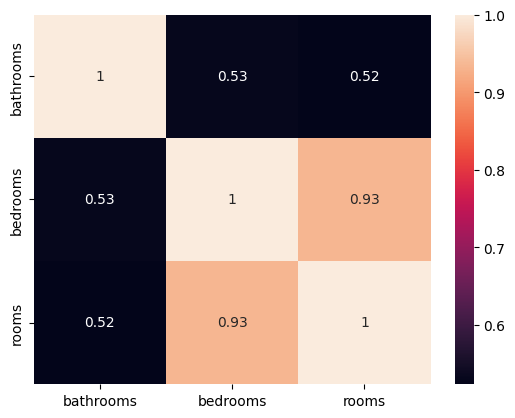

In [39]:
sns.heatmap(df[['bathrooms','bedrooms','rooms']].corr(),annot=True)

The bathrooms col still has empty rows since the rooms col should be the sum of bedrooms and bathrooms col, a simple artihmetic may solve the issue of nan values.

It seems that the sum of #bed+#bath != #rooms. 

This is somewhat of a problem as we now have a source of slight confusion as to what the rooms col actually indicates. 

Some of the probable causes maybe that in the dataset the 'bathroomns' col refers to bathrooms that are not attached to the rooms, and it counts attached bathrooms (bed+bath) as bedrooms/rooms. 

The correlation seems to very high between rooms and bedrooms, meaning we can keep one and discard the other. 

A good imputation strategy for bathrooms col seem to be the mode. Again, without knowing what the actual room col is or if the bed+bath hypothesis is true our best bet at this point seems to be impute the NaN bathrooms values with the mode. Discard the rooms col due to the seemingly high correlation.

Make the changes and see the results again.

In [40]:
def wrangle(file_path):

    # read the csv file 
    df = pd.read_csv(file_path)

    # Remove the cols that don't provide any useful info and also the high cardinality cols
    cols_to_remove = [
        'start_date','end_date','created_on','l1','currency','operation_type',
        'description','title'
                      ]
    
    # Filter the df to exclude properties > 5e5 / 500_000 and less than 1e4/ 10_000
    mask_price = (df.price<=5e5) & (df.price>1e4)
    # Filter properties to contain only apartments, condos and, houses/homes
    mask_property_type = df.property_type.isin(['PH', 'Departamento','Casa']) 

    # Filter df to only  include properties in the captial fedeeral district
    mask_city = df['l2']=='Capital Federal'
    cols_to_remove.append('l2')
    
    # Filter the surface_covered and surface_total cols to remove the outliers.
    Q1_surface_c = df['surface_covered'].quantile(0.25)
    Q3_surface_c = df['surface_covered'].quantile(0.75)
    IQR_surface_c = Q3_surface_c - Q1_surface_c

    Q1_surface_t = df['surface_total'].quantile(0.25)
    Q3_surface_t = df['surface_total'].quantile(0.75)
    IQR_surface_t = Q3_surface_t - Q1_surface_t

    mask_surface_c = df['surface_covered'].between(Q1_surface_c - 1.5 * IQR_surface_c, Q3_surface_c + 1.5 * IQR_surface_c)
    mask_surface_t = df['surface_total'].between(Q1_surface_t - 1.5 * IQR_surface_t, Q3_surface_t + 1.5 * IQR_surface_t)

    # Drop NaN entries in the lat and lon columns
    df = df.dropna(subset=['lat','lon'])
    
    # Impute the missing bathrooms col with the mode
    df ['bathrooms'] =  df['bathrooms'].fillna(df.bathrooms.mode()[0])

    # Drop the rooms col due to high correlation
    cols_to_remove.append('rooms')

    # Drop the entries with missing sufface_total cols
    df = df.dropna()

    # Apply the masks
    df  = df.loc[mask_price & mask_property_type & mask_city & mask_surface_c & mask_surface_t]
  

    # Change the property_type col values to ENG
    df['property_type'] = df.property_type.map(
    {
        'Departamento':'Apartment',
        'Casa':'House',
        'PH':'Condo'
     } 
    )

    # Remove cols

    df = df.drop(cols_to_remove,axis=1)

    return df

In [41]:
df = wrangle(file_path)
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 69774 entries, 0 to 146557
Data columns (total 9 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   lat              69774 non-null  float64
 1   lon              69774 non-null  float64
 2   l3               69774 non-null  object 
 3   bedrooms         69774 non-null  float64
 4   bathrooms        69774 non-null  float64
 5   surface_total    69774 non-null  float64
 6   surface_covered  69774 non-null  float64
 7   price            69774 non-null  float64
 8   property_type    69774 non-null  object 
dtypes: float64(7), object(2)
memory usage: 5.3+ MB


This the wrangled/pre-processed dataset that we will be using.

In [42]:
# Split the data into features matrix (X) and target var (Y)
X = df.drop('price',axis=1)
y = df.price


C:\Users\islam\AppData\Local\Temp\ipykernel_28872\1561390099.py:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(X.corr(),annot=True)


<AxesSubplot: >

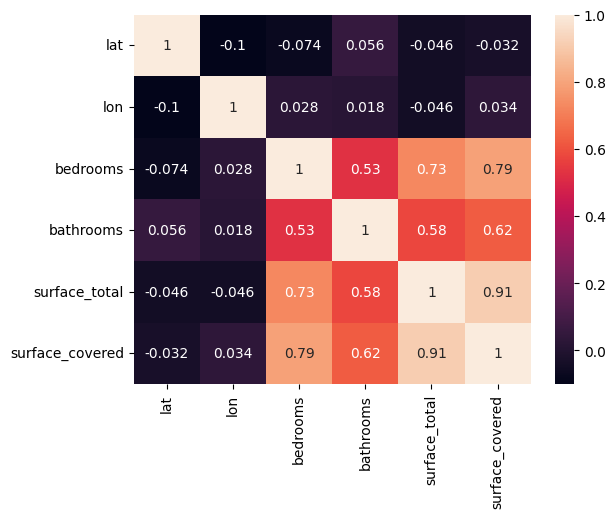

In [43]:
# Last check to see if we have any redundant features and to see corr. between the selected features.
sns.heatmap(X.corr(),annot=True)

There are some features (surface_covered and surface_total) with very high correlation however, since we are using a tree based model I have decied to keep both of these features. For our final model we have six features. 

In [47]:
fig = px.scatter_mapbox(
    df,
    lat=df.lat,
    lon=df.lon,
    center={'lat':df.lat.mean(),'lon':df.lon.mean()},
    color=df.price,
    width=600,
    height=500,
    hover_data=['price'],
    zoom=10

)

fig.update_layout(mapbox_style='open-street-map')

fig.show()

Interactive map higlighting the loc(lat,lon) and price of all the properties in our wrangled dataset.

In [48]:
# Splitting the data into training and test sets to 
# ensure we have set aside some unseen data to test/validate the model. 

from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.2, random_state=42) 

In [49]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import cross_val_score
import optuna

# Define columns
num_cols = ['surface_covered', 'surface_total', 'bedrooms', 'bathrooms', 'lat','lon']  # Add your complete numeric feature list
cat_cols = ['l3','property_type']

# Preprocessor (only cat cols are encoded the rest of the features are left as is)
preprocessor = ColumnTransformer([
    ('cat', OneHotEncoder(handle_unknown='ignore',sparse=False), cat_cols)
], remainder='passthrough')

# Optuna objective function
def objective(trial):
    rf = RandomForestRegressor(
        n_estimators=trial.suggest_int('n_estimators', 100, 1000),
        max_depth=trial.suggest_int('max_depth', 5, 30),
        min_samples_split=trial.suggest_int('min_samples_split', 2, 10),
        min_samples_leaf=trial.suggest_int('min_samples_leaf', 1, 10),
        max_features=trial.suggest_categorical('max_features', ['auto', 'sqrt', 'log2']),
        random_state=42,
        n_jobs=-1
    )

    pipeline = Pipeline([
        ('preprocessor', preprocessor),
        ('model', rf)
    ])

    score = cross_val_score(pipeline, X_train, y_train, cv=3, scoring='neg_root_mean_squared_error')
    return -score.mean()

# Run Optuna
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=50)

c:\Users\islam\anaconda3\envs\DeepLearning_cuda\lib\site-packages\tqdm\auto.py:21: TqdmWarning:

IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html

[I 2025-05-21 01:01:42,791] A new study created in memory with name: no-name-01c1d856-754f-406c-99a6-afc2ac84353d
c:\Users\islam\anaconda3\envs\DeepLearning_cuda\lib\site-packages\sklearn\ensemble\_forest.py:416: FutureWarning:

`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.

c:\Users\islam\anaconda3\envs\DeepLearning_cuda\lib\site-packages\sklearn\ensemble\_forest.py:416: FutureWarning:

`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the d

We can use multiple algorithms during this phase, then compare the performance of diff. algortihms. However the dataset is old, that is the records are during the ealry stages of covid-19. A lot of has changed during these times in Argentina economically, so these prices may not retain their significance in the present.

Random Forest algorthim was choses as it traditionally a proven algorithm with a track record of getting acceptable accurary in such use cases. It does not need your data to be scaled, the algorithm is robust to outliers, less prone to overfitting, allows us to easily indentify important features.



In [50]:
optuna.visualization.plot_contour(study)

In [51]:
from optuna.visualization import (
    plot_optimization_history,
    plot_slice,
    plot_param_importances,
    plot_parallel_coordinate
)

# Plot optimization history (RMSE vs trials)
plot_optimization_history(study).show()

# Plot parameter relationships
plot_parallel_coordinate(study).show()

# Plot parameter impact on performance
plot_param_importances(study).show()

# Slice plots (RMSE distribution per parameter)
plot_slice(study).show()

Optuna study results visualized.


In [52]:
best_params = study.best_params
best_params

{'n_estimators': 530,
 'max_depth': 29,
 'min_samples_split': 3,
 'min_samples_leaf': 1,
 'max_features': 'auto'}

In [ ]:
'''
Best params dict

{'n_estimators': 530,
 'max_depth': 29,
 'min_samples_split': 3,
 'min_samples_leaf': 1,
 'max_features': 'auto'}

'''

Let's create a streamlined version of what we did taking away all of the exploratory steps we did to arrive at the final conclusion.

In [53]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
from pathlib import Path

In [54]:
work_dir = Path.cwd()
work_dir
file_path = work_dir/'bsas_realstate_on_sale_properati_dataset_2020.csv'
work_dir

WindowsPath('c:/Users/islam/Downloads/Learn Python/TheForage/BritishAirways/buenos_aires_RealEstate')

In [55]:
def wrangle(file_path):

    # read the csv file 
    df = pd.read_csv(file_path)

    # Remove the cols that don't provide any useful info and also the high cardinality cols
    cols_to_remove = [
        'start_date','end_date','created_on','l1','currency','operation_type',
        'description','title'
                      ]
    
    # Filter the df to exclude properties > 5e5 / 500_000 and less than 1e4/ 10_000
    mask_price = (df.price<=5e5) & (df.price>1e4)
    # Filter properties to contain only apartments, condos and, houses/homes
    mask_property_type = df.property_type.isin(['PH', 'Departamento','Casa']) 

    # Filter df to only  include properties in the captial fedeeral district
    mask_city = df['l2']=='Capital Federal'
    cols_to_remove.append('l2')
    
    # Filter the surface_covered and surface_total cols to remove the outliers.
    Q1_surface_c = df['surface_covered'].quantile(0.25)
    Q3_surface_c = df['surface_covered'].quantile(0.75)
    IQR_surface_c = Q3_surface_c - Q1_surface_c

    Q1_surface_t = df['surface_total'].quantile(0.25)
    Q3_surface_t = df['surface_total'].quantile(0.75)
    IQR_surface_t = Q3_surface_t - Q1_surface_t

    mask_surface_c = df['surface_covered'].between(Q1_surface_c - 1.5 * IQR_surface_c, Q3_surface_c + 1.5 * IQR_surface_c)
    mask_surface_t = df['surface_total'].between(Q1_surface_t - 1.5 * IQR_surface_t, Q3_surface_t + 1.5 * IQR_surface_t)

    # Drop NaN entries in the lat and lon columns
    df = df.dropna(subset=['lat','lon'])
    
    # Impute the missing bathrooms col with the mode
    df ['bathrooms'] =  df['bathrooms'].fillna(df.bathrooms.mode()[0])

    # Drop the rooms col due to high correlation
    cols_to_remove.append('rooms')

    # Drop the entries with missing sufface_total cols
    df = df.dropna()

    # Apply the masks
    df  = df.loc[mask_price & mask_property_type & mask_city & mask_surface_c & mask_surface_t]
  

    # Change the property_type col values to ENG
    df['property_type'] = df.property_type.map(
    {
        'Departamento':'Apartment',
        'Casa':'House',
        'PH':'Condo'
     } 
    )

    # Remove cols

    df = df.drop(cols_to_remove,axis=1)

    return df

In [56]:
df = wrangle(file_path)
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 69774 entries, 0 to 146557
Data columns (total 9 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   lat              69774 non-null  float64
 1   lon              69774 non-null  float64
 2   l3               69774 non-null  object 
 3   bedrooms         69774 non-null  float64
 4   bathrooms        69774 non-null  float64
 5   surface_total    69774 non-null  float64
 6   surface_covered  69774 non-null  float64
 7   price            69774 non-null  float64
 8   property_type    69774 non-null  object 
dtypes: float64(7), object(2)
memory usage: 5.3+ MB


In [72]:
df.to_csv('data/cleaned_properties.csv')

In [ ]:
df.head()

,lat,lon,l3,bedrooms,bathrooms,surface_total,surface_covered,price,property_type
0,-34.605880,-58.384949,San Cristobal,7.0,2.0,140.0,140.0,153000.0,Apartment
1,-34.624056,-58.412110,Boedo,1.0,2.0,70.0,58.0,159000.0,Condo
2,-34.593569,-58.427474,Palermo,1.0,1.0,45.0,45.0,125000.0,Condo
3,-34.581294,-58.436754,Palermo,1.0,1.0,85.0,50.0,295000.0,Condo
5,-34.593779,-58.441239,Villa Crespo,1.0,1.0,56.0,56.0,150000.0,Condo


In [58]:
fig = px.scatter_mapbox(
    df,
    lat=df.lat,
    lon=df.lon,
    center={'lat':df.lat.mean(),'lon':df.lon.mean()},
    color=df.price,
    width=600,
    height=500,
    hover_data=['price'],
    zoom=10

)

fig.update_layout(mapbox_style='open-street-map')

fig.show()

In [59]:
from sklearn.model_selection import train_test_split


X = df.drop('price',axis=1)
y = df.price

X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.2, random_state=42) 


In [60]:
test_data = pd.concat([X_test,y_test],axis=1)
test_data.to_csv('data/test_properties.csv')

In [61]:
X_test.head()

,lat,lon,l3,bedrooms,bathrooms,surface_total,surface_covered,property_type
33353,-34.625134,-58.417622,Boedo,3.0,2.0,83.0,75.0,Apartment
131231,-34.604356,-58.398462,Balvanera,2.0,1.0,75.0,67.0,Apartment
65661,-34.608524,-58.399250,Once,2.0,1.0,80.0,80.0,Apartment
135628,-34.599415,-58.424753,Palermo,1.0,1.0,35.0,33.0,Apartment
133326,-34.591165,-58.412078,Palermo,1.0,1.0,29.0,25.0,Apartment


In [62]:
y_test.head()

33353     220000.0
131231    120000.0
65661      90000.0
135628     86000.0
133326     95000.0
Name: price, dtype: float64

In [63]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline

# Define columns
num_cols = X.select_dtypes('number').columns
cat_cols = X.select_dtypes('object').columns

# Preprocessor
preprocessor = ColumnTransformer([
    ('cat', OneHotEncoder(handle_unknown='ignore',sparse=False), cat_cols)
], remainder='passthrough')

In [64]:
rf = RandomForestRegressor(
        n_estimators= 530,
 max_depth= 29,
 min_samples_split= 3,
 min_samples_leaf= 1,
 max_features = 'auto',
        random_state=42,
        n_jobs=-1
    )

pipeline = Pipeline([
        ('preprocessor', preprocessor),
        ('model', rf)
    ])



In [65]:
pipeline.fit(X_train,y_train)

c:\Users\islam\anaconda3\envs\DeepLearning_cuda\lib\site-packages\sklearn\ensemble\_forest.py:416: FutureWarning:

`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.



Pipeline(steps=[('preprocessor',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('cat',
                                                  OneHotEncoder(handle_unknown='ignore',
                                                                sparse=False),
                                                  Index(['l3', 'property_type'], dtype='object'))])),
                ('model',
                 RandomForestRegressor(max_depth=29, max_features='auto',
                                       min_samples_split=3, n_estimators=530,
                                       n_jobs=-1, random_state=42))])

In [74]:
import pickle

with open('model/pipeline.pkl', 'wb') as f:
    pickle.dump(pipeline, f)

In [75]:
from sklearn.metrics import mean_absolute_error

y_train_pred_baseline = [y_train.mean()] * len(y_train)

mae_baseline_y_train = mean_absolute_error(y_train,y_train_pred_baseline)
mae_baseline_y_train

75101.97231531859

In [76]:
mae_test = mean_absolute_error(y_test,pipeline.predict(X_test))
mae_test

14226.619624120747

In [77]:
mae_train = mean_absolute_error(y_train,pipeline.predict(X_train))
mae_train

6665.407613963712

We observe very significant improvement in predicting prices when compared to the baseline prediction. The margin of error for both the train and test sets remain within acceptable levels.

In [78]:
importances = pipeline.named_steps.model.feature_importances_
features = pipeline.named_steps.preprocessor.get_feature_names_out()
feat_imp = pd.Series(importances,index=features).sort_values(ascending=True)

In [79]:
feat_imp.head()

cat__l3_Catalinas          5.335793e-07
cat__l3_Villa Riachuelo    1.198971e-05
cat__l3_Villa Soldati      1.941222e-05
cat__l3_Velez Sarsfield    2.668870e-05
cat__l3_Villa Real         2.902793e-05
dtype: float64

In [71]:
feat_imp_viz = feat_imp.tail(10)
fig = px.bar(feat_imp_viz, x=feat_imp_viz.values,y=feat_imp_viz.index,title='Feature Importances')
fig.update_layout(xaxis_title='Importances',yaxis_title='Featrures')
fig.show()

The 10 most important features for the model are highlighted in the graph above.